<a href="https://colab.research.google.com/github/ella00100/RenewableEnergyModel/blob/main/RenewableEnergy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [171]:
from google.colab import files
uploaded = files.upload()

Saving test_data.csv to test_data (6).csv


In [172]:
import io
import pandas as pd
data = pd.read_csv('test_data.csv')

In [173]:
train = data.copy()

In [174]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10478 entries, 0 to 10477
Data columns (total 29 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   일자         10478 non-null  object 
 1   구분1        10478 non-null  object 
 2   발전소코드      10478 non-null  object 
 3   발전소용량(KW)  10478 non-null  float64
 4   0:00       10478 non-null  float64
 5   1:00       10478 non-null  float64
 6   2:00       10478 non-null  object 
 7   3:00       10478 non-null  object 
 8   4:00       10478 non-null  object 
 9   5:00       10478 non-null  float64
 10  6:00       10478 non-null  float64
 11  7:00       10478 non-null  float64
 12  8:00       10478 non-null  float64
 13  9:00       10478 non-null  float64
 14  10:00      10478 non-null  float64
 15  11:00      10478 non-null  float64
 16  12:00      10478 non-null  float64
 17  13:00      10478 non-null  float64
 18  14:00      10478 non-null  float64
 19  15:00      10478 non-null  float64
 20  16:00 

In [175]:
train.head()

,일자,구분1,발전소코드,발전소용량(KW),0:00,1:00,2:00,3:00,4:00,5:00,...,15:00,16:00,17:00,18:00,19:00,20:00,21:00,22:00,23:00,합계
0,2023-03-01,실측,G1053,249.48,0.00,0.00,0,0,0,0.00,...,0.10,65.80,33.60,133.70,161.1,150.5,0,0,0,640.90
1,2023-03-01,예측,G1053,249.48,0.95,0.97,0.94,0.97,0.96,0.95,...,20.08,93.61,35.62,161.20,161.2,161.2,46.95,0.89,0.98,739.26
2,2023-03-01,실측,G1018,288.00,0.00,0.00,0,0,0,0.00,...,101.26,53.50,29.09,2.21,0.0,0,0,0,0,787.25
3,2023-03-01,예측,G1018,288.00,0.00,0.00,0,0,0,0.00,...,93.33,30.84,27.05,1.43,0.0,0,0,0,0,618.75
4,2023-03-01,실측,G1034,298.08,12.40,0.00,0,0,0,0.00,...,18.60,63.80,28.80,0.60,0.0,164.2,135.6,0,0,552.40


In [176]:
#중복된 데이터 확인
sum(train.duplicated())

0

In [177]:
train['일자'] = pd.to_datetime(train['일자'])

In [178]:
train = train.rename(columns={'일자':'date'})
train = train.rename(columns={'구분1': 'type1'})
train = train.rename(columns={'발전소코드':'power_plant_code'})
train = train.rename(columns={'발전소용량(KW)':'power_plant_capacity'})
train = train.rename(columns={'합계':'sum'})

In [179]:
train.head()

,date,type1,power_plant_code,power_plant_capacity,0:00,1:00,2:00,3:00,4:00,5:00,...,15:00,16:00,17:00,18:00,19:00,20:00,21:00,22:00,23:00,sum
0,2023-03-01,실측,G1053,249.48,0.00,0.00,0,0,0,0.00,...,0.10,65.80,33.60,133.70,161.1,150.5,0,0,0,640.90
1,2023-03-01,예측,G1053,249.48,0.95,0.97,0.94,0.97,0.96,0.95,...,20.08,93.61,35.62,161.20,161.2,161.2,46.95,0.89,0.98,739.26
2,2023-03-01,실측,G1018,288.00,0.00,0.00,0,0,0,0.00,...,101.26,53.50,29.09,2.21,0.0,0,0,0,0,787.25
3,2023-03-01,예측,G1018,288.00,0.00,0.00,0,0,0,0.00,...,93.33,30.84,27.05,1.43,0.0,0,0,0,0,618.75
4,2023-03-01,실측,G1034,298.08,12.40,0.00,0,0,0,0.00,...,18.60,63.80,28.80,0.60,0.0,164.2,135.6,0,0,552.40


In [180]:
for col in train.columns:
    if train[col].dtype == 'object':
      if col != 'type1' and col != 'power_plant_code':
        train[col] = pd.to_numeric(train[col], errors='coerce')


In [181]:
train.dtypes

date                    datetime64[ns]
type1                           object
power_plant_code                object
power_plant_capacity           float64
0:00                           float64
1:00                           float64
2:00                           float64
3:00                           float64
4:00                           float64
5:00                           float64
6:00                           float64
7:00                           float64
8:00                           float64
9:00                           float64
10:00                          float64
11:00                          float64
12:00                          float64
13:00                          float64
14:00                          float64
15:00                          float64
16:00                          float64
17:00                          float64
18:00                          float64
19:00                          float64
20:00                          float64
21:00                    

In [182]:
train.isna().sum()

date                    0
type1                   0
power_plant_code        0
power_plant_capacity    0
0:00                    0
1:00                    0
2:00                    1
3:00                    2
4:00                    1
5:00                    0
6:00                    0
7:00                    0
8:00                    0
9:00                    0
10:00                   0
11:00                   0
12:00                   0
13:00                   0
14:00                   0
15:00                   0
16:00                   0
17:00                   0
18:00                   0
19:00                   0
20:00                   1
21:00                   2
22:00                   1
23:00                   1
sum                     0
dtype: int64

In [183]:
na_rows = train[train.isna().any(axis=1)]
print(na_rows)

           date type1 power_plant_code  power_plant_capacity  0:00  1:00  \
224  2023-03-02    실측            S5024                 427.0   0.0   0.0   
1224 2023-03-06    실측            S5024                 427.0   0.0   0.0   
2474 2023-03-11    실측            S5024                 427.0   0.0   0.0   
2974 2023-03-13    실측            S5024                 427.0   0.0   0.0   
3974 2023-03-17    실측            S5024                 427.0   0.0   0.0   
4474 2023-03-19    실측            S5024                 427.0   0.0   0.0   
5224 2023-03-22    실측            S5024                 427.0   0.0   0.0   
6224 2023-03-26    실측            S5024                 427.0   0.0   0.0   
6974 2023-03-29    실측            S5024                 427.0   0.0   0.0   

      2:00  3:00  4:00  5:00  ...   15:00   16:00   17:00  18:00  19:00  \
224    0.0   NaN   0.0   0.0  ...  594.53  400.11  129.09  11.54   0.00   
1224   0.0   0.0   0.0   0.0  ...  500.38  313.21  108.61  10.74   0.02   
2474   0.0   0

In [184]:
train.fillna(0, inplace=True)

In [186]:
train.isna().sum()

date                    0
type1                   0
power_plant_code        0
power_plant_capacity    0
0:00                    0
1:00                    0
2:00                    0
3:00                    0
4:00                    0
5:00                    0
6:00                    0
7:00                    0
8:00                    0
9:00                    0
10:00                   0
11:00                   0
12:00                   0
13:00                   0
14:00                   0
15:00                   0
16:00                   0
17:00                   0
18:00                   0
19:00                   0
20:00                   0
21:00                   0
22:00                   0
23:00                   0
sum                     0
dtype: int64

In [189]:
code_count = train['power_plant_code'].nunique()
# 발전소 코드 개수 중복 없이 세기
print(f"발전소 코드의 개수: {code_count}")

발전소 코드의 개수: 169


In [190]:
def update_label(value):
    if value == '실측':
        return 1
    elif value == '예측':
        return 0
    else:
        return value

train['type1'] = train['type1'].apply(update_label)

In [191]:
train.head()

,date,type1,power_plant_code,power_plant_capacity,0:00,1:00,2:00,3:00,4:00,5:00,...,15:00,16:00,17:00,18:00,19:00,20:00,21:00,22:00,23:00,sum
0,2023-03-01,1,G1053,249.48,0.00,0.00,0.00,0.00,0.00,0.00,...,0.10,65.80,33.60,133.70,161.1,150.5,0.00,0.00,0.00,640.90
1,2023-03-01,0,G1053,249.48,0.95,0.97,0.94,0.97,0.96,0.95,...,20.08,93.61,35.62,161.20,161.2,161.2,46.95,0.89,0.98,739.26
2,2023-03-01,1,G1018,288.00,0.00,0.00,0.00,0.00,0.00,0.00,...,101.26,53.50,29.09,2.21,0.0,0.0,0.00,0.00,0.00,787.25
3,2023-03-01,0,G1018,288.00,0.00,0.00,0.00,0.00,0.00,0.00,...,93.33,30.84,27.05,1.43,0.0,0.0,0.00,0.00,0.00,618.75
4,2023-03-01,1,G1034,298.08,12.40,0.00,0.00,0.00,0.00,0.00,...,18.60,63.80,28.80,0.60,0.0,164.2,135.60,0.00,0.00,552.40


In [193]:
code_list = []

def split_dataframe_by_code(df, code_column):
    # 발전소 코드별로 데이터프레임을 분할하여 사전 형태로 저장
    data_dict = {}
    unique_codes = df[code_column].unique()
    for code in unique_codes:
        data_dict[code] = df[df[code_column] == code].copy()

    return data_dict

# '발전소코드' 열을 기준으로 데이터프레임을 분할
data_by_code = split_dataframe_by_code(train, 'power_plant_code')

# 분할된 데이터프레임에 자동으로 새로운 이름 지정
for i, (code, data) in enumerate(data_by_code.items()):
    new_name = f"code{i+1}"
    globals()[new_name] = data
    code_list.append(globals()[new_name])
    file_name = f"code{i+1}.csv"
    data.to_csv(file_name, index=False)


In [194]:
print(code_list)

[           date  type1 power_plant_code  power_plant_capacity  0:00  1:00  \
0    2023-03-01      1            G1053                249.48  0.00  0.00   
1    2023-03-01      0            G1053                249.48  0.95  0.97   
194  2023-03-02      1            G1053                249.48  0.00  0.00   
195  2023-03-02      0            G1053                249.48  1.01  1.03   
444  2023-03-03      1            G1053                249.48  0.00  0.00   
...         ...    ...              ...                   ...   ...   ...   
6945 2023-03-29      0            G1053                249.48  0.99  0.95   
7194 2023-03-30      1            G1053                249.48  0.00  0.00   
7195 2023-03-30      0            G1053                249.48  1.01  0.97   
7444 2023-03-31      1            G1053                249.48  0.00  0.00   
7445 2023-03-31      0            G1053                249.48  0.99  0.97   

      2:00  3:00  4:00  5:00  ...   15:00   16:00  17:00  18:00  19:00  20

In [195]:
print(code1)

           date  type1 power_plant_code  power_plant_capacity  0:00  1:00  \
0    2023-03-01      1            G1053                249.48  0.00  0.00   
1    2023-03-01      0            G1053                249.48  0.95  0.97   
194  2023-03-02      1            G1053                249.48  0.00  0.00   
195  2023-03-02      0            G1053                249.48  1.01  1.03   
444  2023-03-03      1            G1053                249.48  0.00  0.00   
...         ...    ...              ...                   ...   ...   ...   
6945 2023-03-29      0            G1053                249.48  0.99  0.95   
7194 2023-03-30      1            G1053                249.48  0.00  0.00   
7195 2023-03-30      0            G1053                249.48  1.01  0.97   
7444 2023-03-31      1            G1053                249.48  0.00  0.00   
7445 2023-03-31      0            G1053                249.48  0.99  0.97   

      2:00  3:00  4:00  5:00  ...   15:00   16:00  17:00  18:00  19:00  20:

In [196]:
print(code169)

            date  type1 power_plant_code  power_plant_capacity  0:00  1:00  \
8830  2023-03-01      1            V9027                 470.0   0.0   0.0   
8851  2023-03-01      0            V9027                 470.0   0.0   0.0   
8878  2023-03-02      1            V9027                 470.0   0.0   0.0   
8899  2023-03-02      0            V9027                 470.0   0.0   0.0   
8926  2023-03-03      1            V9027                 470.0   0.0   0.0   
...          ...    ...              ...                   ...   ...   ...   
10195 2023-03-29      0            V9027                 470.0   0.0   0.0   
10222 2023-03-30      1            V9027                 470.0   0.0   0.0   
10243 2023-03-30      0            V9027                 470.0   0.0   0.0   
10270 2023-03-31      1            V9027                 470.0   0.0   0.0   
10291 2023-03-31      0            V9027                 470.0   0.0   0.0   

       2:00  3:00  4:00  5:00  ...   15:00   16:00  17:00  18:0

In [199]:
def calculate_diff_values(dataframe):
    diff_values = []
    time_columns = dataframe.columns[4:-1]  # 시간대 열의 범위

    for date in dataframe['date'].unique():
        temp_row = {'date': date}
        for time_col in time_columns:
            diff = dataframe[(dataframe['date'] == date) & (dataframe['type1'] == 1)][time_col].values[0] - dataframe[(dataframe['date'] == date) & (dataframe['type1'] == 0)][time_col].values[0]
            temp_row[time_col] = diff
        diff_values.append(temp_row)

    diff_df = pd.DataFrame(diff_values)
    return diff_df

In [201]:
code1_diff = calculate_diff_values(code1)
print(code1_diff)

         date  0:00  1:00  2:00  3:00  4:00  5:00  6:00  7:00   8:00  ...  \
0  2023-03-01 -0.95 -0.97 -0.94 -0.97 -0.96 -0.95 -1.00 -1.89   4.64  ...   
1  2023-03-02 -1.01 -1.03 -1.02 -1.02 -1.02 -1.02 -1.03 -2.17  -9.23  ...   
2  2023-03-03 -1.01 -1.03 -1.02 -1.02 -1.03 -1.02 -1.00 -1.75  -9.14  ...   
3  2023-03-04 -0.96 -0.97 -0.96 -0.97 -0.94 -0.94 -0.98  0.93   3.00  ...   
4  2023-03-05 -0.98 -0.96 -0.98 -1.00 -0.97 -0.96 -0.98 -1.62  -8.27  ...   
5  2023-03-06 -0.97 -0.97 -0.96 -0.96 -0.94 -0.92 -0.96 -1.13  -9.48  ...   
6  2023-03-07 -0.97 -0.96 -0.98 -0.95 -0.97 -0.94 -0.96 -0.12  -4.54  ...   
7  2023-03-08 -0.98 -0.97 -0.99 -0.97 -0.98 -0.89 -0.95  0.82  -8.78  ...   
8  2023-03-09 -0.89 -0.93 -1.00 -0.99 -0.99 -0.94 -0.97 -4.46 -20.37  ...   
9  2023-03-10 -0.97 -0.93 -0.93 -0.94 -0.92 -0.88 -0.95 -2.18 -14.53  ...   
10 2023-03-11 -0.92 -0.95 -0.97 -0.98 -0.97 -0.90 -0.95 -0.09  12.27  ...   
11 2023-03-12 -0.99 -0.97 -0.98 -0.97 -0.97 -0.96 -0.96 -2.55  -6.28  ...   

In [202]:
diff_results=[]

In [203]:
for code_df in code_list:
    diff_df = calculate_diff_values(code_df)
    diff_results.append(diff_df)

In [204]:
diff_dataframes = []

for i, diff_df in enumerate(diff_results):
    filename = f"code{i+1}_diff.csv"
    diff_df.to_csv(filename, index=False)
    diff_dataframe_name = f"code{i+1}_diff"
    globals()[diff_dataframe_name] = diff_df
    diff_dataframes.append(diff_dataframe_name)

# 결과 확인
for diff_dataframe_name in diff_dataframes:
    print(f"{diff_dataframe_name}:")
    print(globals()[diff_dataframe_name])
    print()

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
23  -77.07  -96.54  -59.35  -37.12  -6.47    0.0    0.0    0.0    0.0    0.0  
24  -56.28  -22.38   -0.64   23.41   0.28    0.0    0.0    0.0    0.0    0.0  
25  -12.75   -7.26   -7.08    3.95   0.12    0.0    0.0    0.0    0.0    0.0  
26 -200.12 -214.91 -168.70  -92.63  -9.76    0.0    0.0    0.0    0.0    0.0  
27   92.09   35.63  -17.08    8.02   0.61    0.0    0.0    0.0    0.0    0.0  
28 -220.84 -133.76 -116.36  -58.94 -10.48    0.0    0.0    0.0    0.0    0.0  
29   39.86   45.35   14.10   58.33  29.35    0.0    0.0    0.0    0.0    0.0  
30  267.61  120.25 -108.23 -106.39   1.07    0.0    0.0    0.0    0.0    0.0  

[31 rows x 25 columns]

code113_diff:
         date  0:00  1:00  2:00  3:00  4:00  5:00  6:00   7:00    8:00  ...  \
0  2023-03-02 -3.85 -3.86 -4.26 -3.68 -2.87 -3.81 -4.70 -16.54   51.82  ...   
1  2023-03-03 -4.35 -2.76 -2.87 -2.75 -2.90 -2.89 -3.04 -14.05   27.68  ...   
2  2023-03-04 -3.21 -2.49 -2.94 -3.02 -3.53 -3.68 -3.07 

In [205]:
code1_diff.head()

,date,0:00,1:00,2:00,3:00,4:00,5:00,6:00,7:00,8:00,...,14:00,15:00,16:00,17:00,18:00,19:00,20:00,21:00,22:00,23:00
0,2023-03-01,-0.95,-0.97,-0.94,-0.97,-0.96,-0.95,-1.00,-1.89,4.64,...,0.20,-19.98,-27.81,-2.02,-27.5,-0.1,-10.7,-46.95,-0.89,-0.98
1,2023-03-02,-1.01,-1.03,-1.02,-1.02,-1.02,-1.02,-1.03,-2.17,-9.23,...,-11.81,-7.91,-3.37,2.47,-27.4,-0.1,-0.1,14.29,-1.00,-1.01
2,2023-03-03,-1.01,-1.03,-1.02,-1.02,-1.03,-1.02,-1.00,-1.75,-9.14,...,-6.94,-11.39,-13.77,-4.49,-27.9,-0.1,-0.1,15.26,-0.94,-0.97
3,2023-03-04,-0.96,-0.97,-0.96,-0.97,-0.94,-0.94,-0.98,0.93,3.00,...,-20.77,-70.95,10.76,2.69,-27.6,-0.1,-0.1,16.18,-0.95,-0.91
4,2023-03-05,-0.98,-0.96,-0.98,-1.00,-0.97,-0.96,-0.98,-1.62,-8.27,...,149.30,99.26,37.61,0.39,-27.7,-0.1,0.0,16.81,-0.89,-0.91


In [206]:
code1_diff.describe()

,0:00,1:00,2:00,3:00,4:00,5:00,6:00,7:00,8:00,9:00,...,14:00,15:00,16:00,17:00,18:00,19:00,20:00,21:00,22:00,23:00
count,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,...,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000,31.000000
mean,-0.917097,-0.924516,-0.930645,-0.938065,-0.930000,-0.922258,-0.947742,-1.910645,-6.638065,-5.812258,...,2.045806,-10.854194,-8.669032,-4.499355,-26.644839,4.379032,14.246774,15.015806,-0.804516,-0.916774
std,0.157357,0.153185,0.142313,0.148288,0.141774,0.086128,0.137494,2.680577,15.295392,25.487645,...,66.879212,53.094927,22.906081,8.873475,7.328810,24.044267,47.978316,24.486642,0.153141,0.131995
min,-1.010000,-1.030000,-1.020000,-1.030000,-1.030000,-1.030000,-1.160000,-9.750000,-49.270000,-53.370000,...,-148.370000,-122.790000,-49.600000,-23.260000,-29.700000,-0.100000,-96.200000,-47.380000,-1.000000,-1.010000
25%,-0.985000,-0.970000,-0.980000,-0.990000,-0.970000,-0.955000,-1.030000,-3.665000,-14.820000,-18.750000,...,-25.235000,-25.470000,-17.410000,-8.690000,-28.100000,-0.100000,-0.200000,13.945000,-0.890000,-0.980000
50%,-0.970000,-0.960000,-0.960000,-0.970000,-0.960000,-0.940000,-0.960000,-2.120000,-9.140000,-11.130000,...,-6.940000,-12.860000,-11.750000,-4.490000,-27.800000,-0.100000,-0.100000,16.170000,-0.870000,-0.960000
75%,-0.940000,-0.940000,-0.940000,-0.950000,-0.940000,-0.910000,-0.950000,-0.105000,3.115000,-2.540000,...,10.640000,0.250000,-3.805000,-0.800000,-27.500000,0.000000,-0.100000,17.090000,-0.750000,-0.915000
max,-0.400000,-0.210000,-0.280000,-0.250000,-0.220000,-0.540000,-0.520000,3.270000,26.530000,62.920000,...,151.900000,129.100000,58.970000,19.400000,12.710000,133.880000,149.660000,66.440000,-0.260000,-0.430000


In [212]:

def plot_diff_values(filename):
    # 파일 읽기
    diff_df = pd.read_csv(filename)

    # 그래프 설정
    plt.figure(figsize=(10, 6))
    plt.title(f"{filename} - date - errorValue")
    plt.xlabel("date")
    plt.ylabel("error_value")
    plt.xticks(rotation=45)
    plt.grid(True)

    # 일자별로 그래프 그리기
    for date in diff_df['date'].unique():
        date_df = diff_df[diff_df['date'] == date]
        time_columns = date_df.columns[1:]  # 시간대 열 범위

        # 시간대별 값 추출
        values = date_df.iloc[0, 1:].values

        # 그래프 그리기
        plt.plot(time_columns, values, label=f"{date}")

    # 범례 추가
    plt.legend()

    # 그래프 표시
    plt.show()


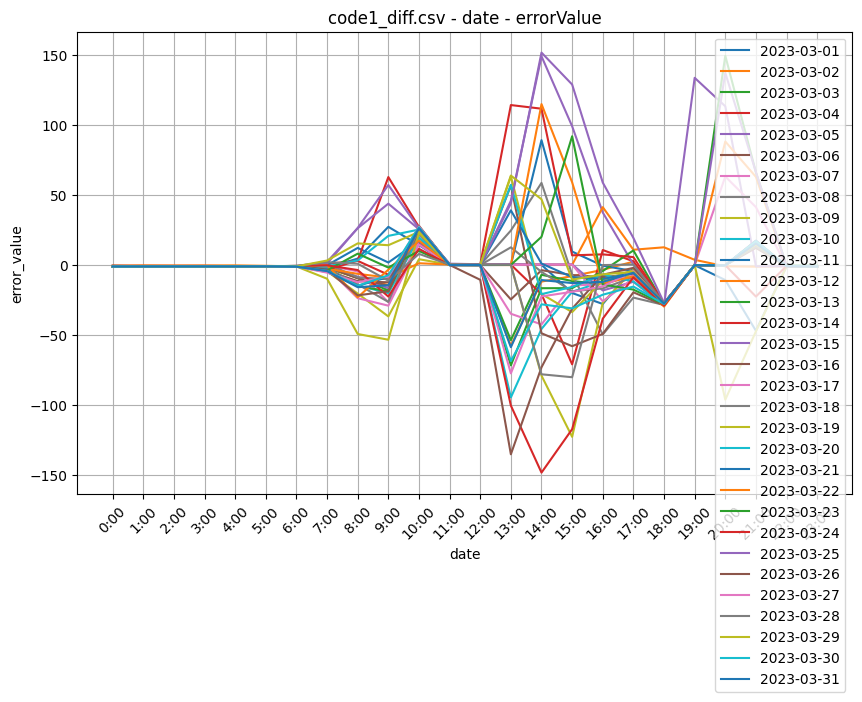

In [213]:
plot_diff_values('code1_diff.csv')

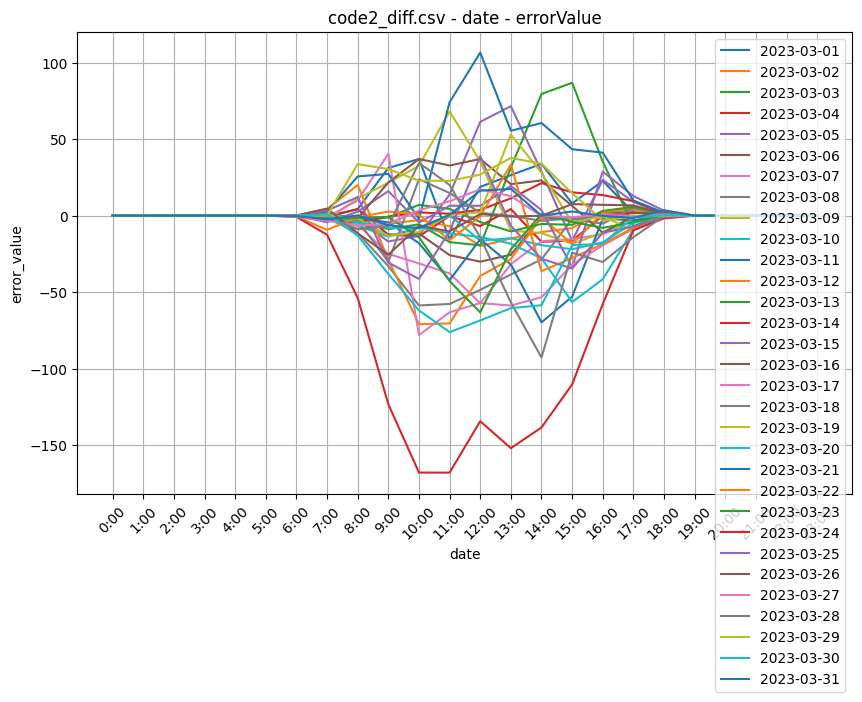

In [214]:
plot_diff_values('code2_diff.csv')

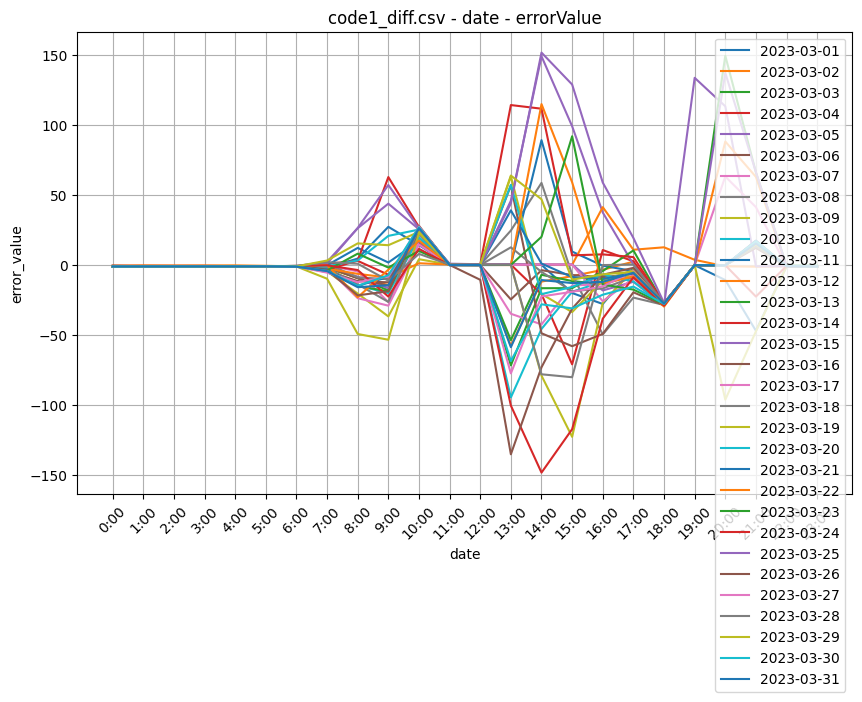

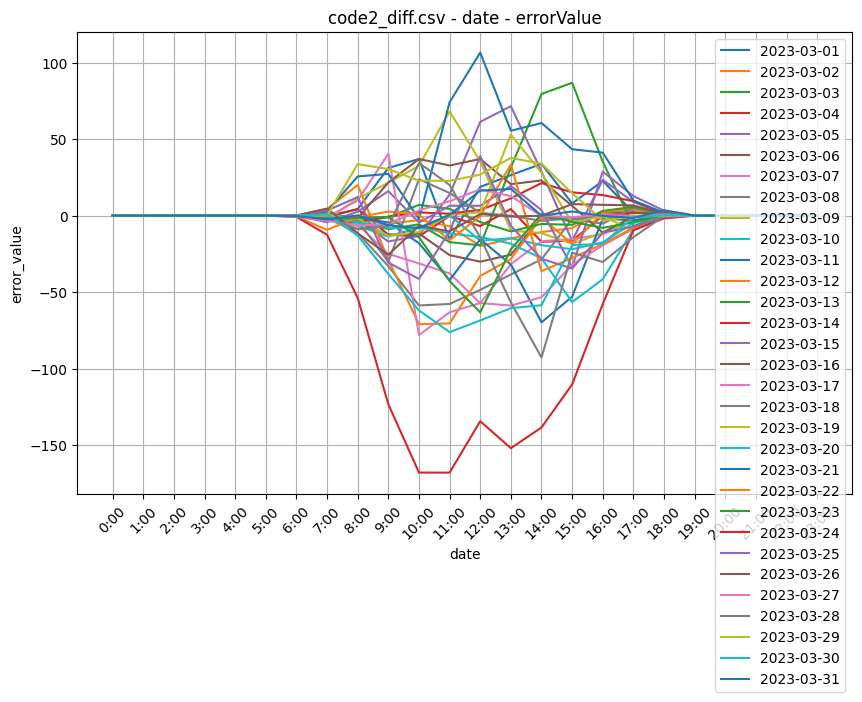

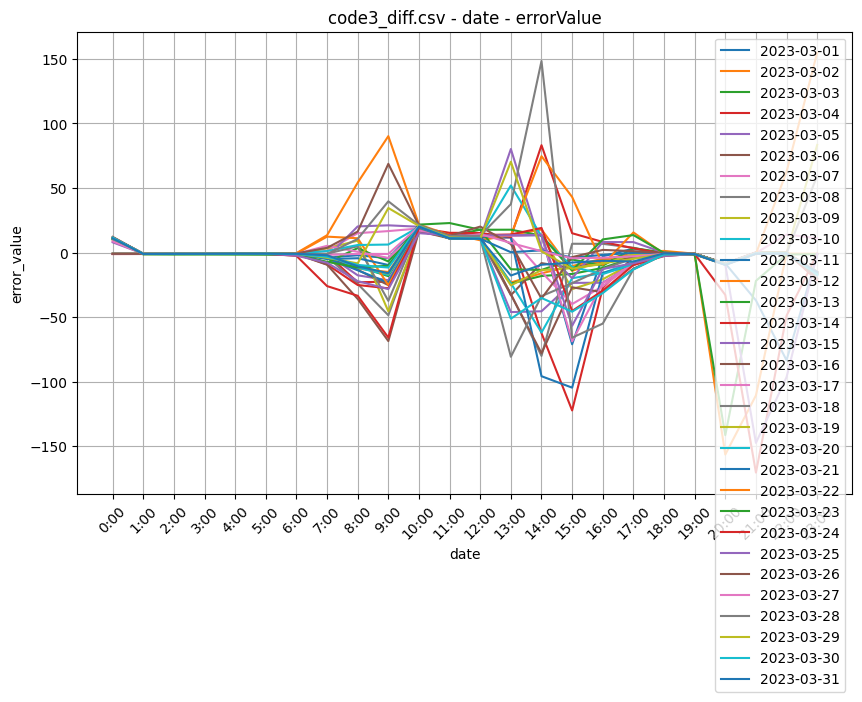

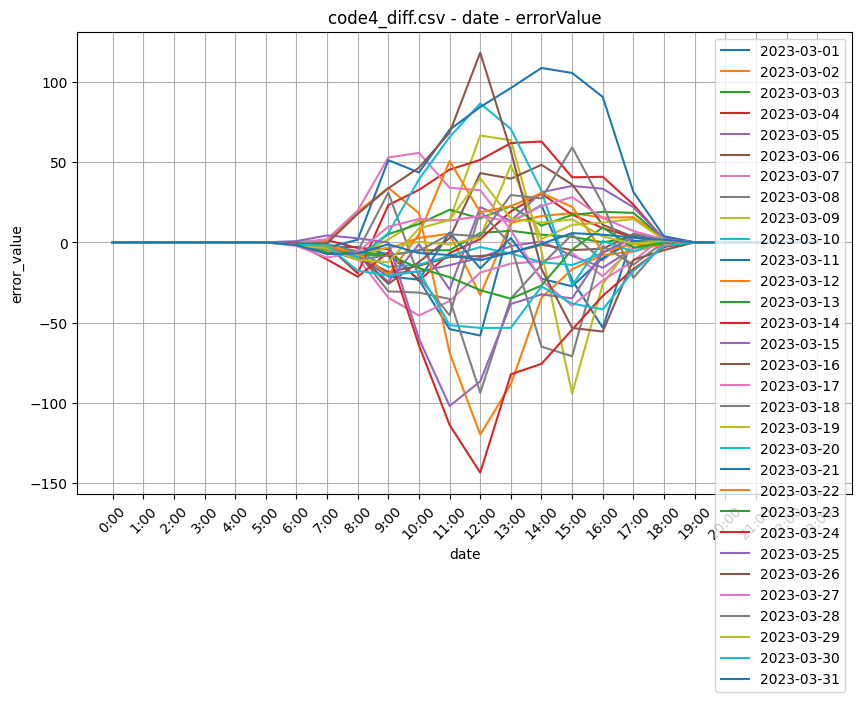

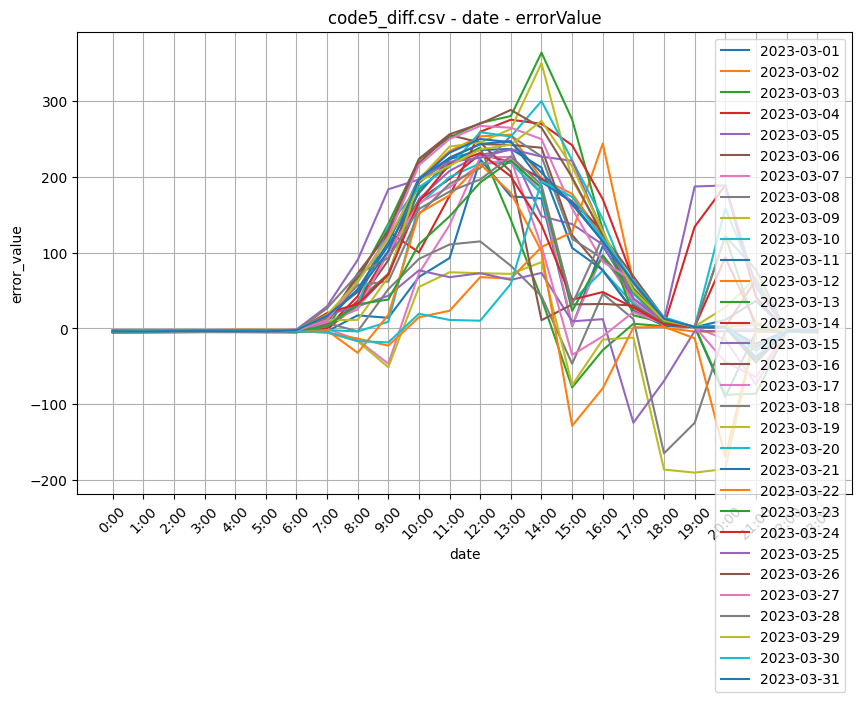

...

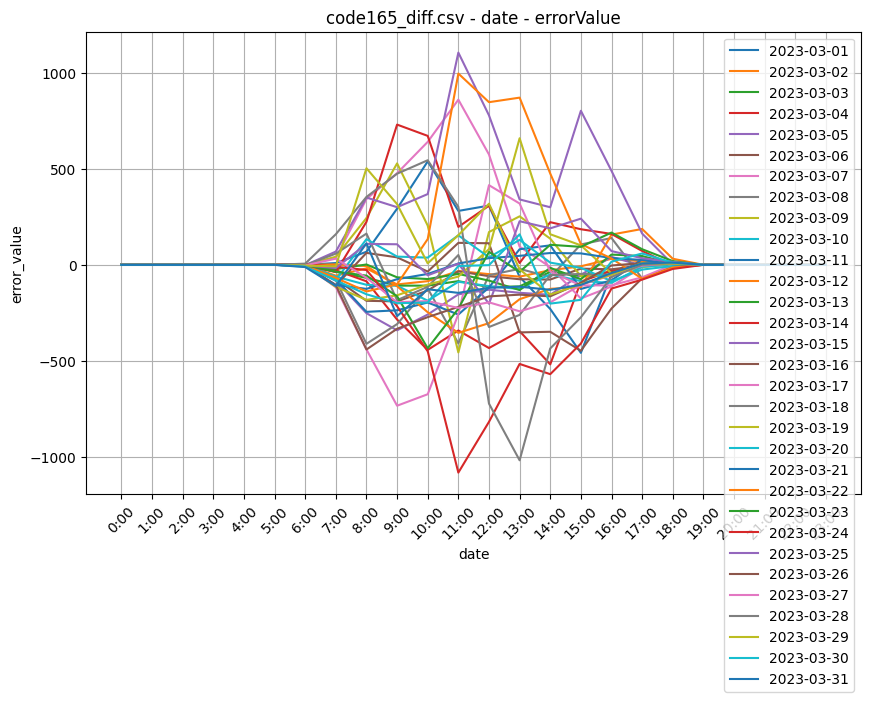

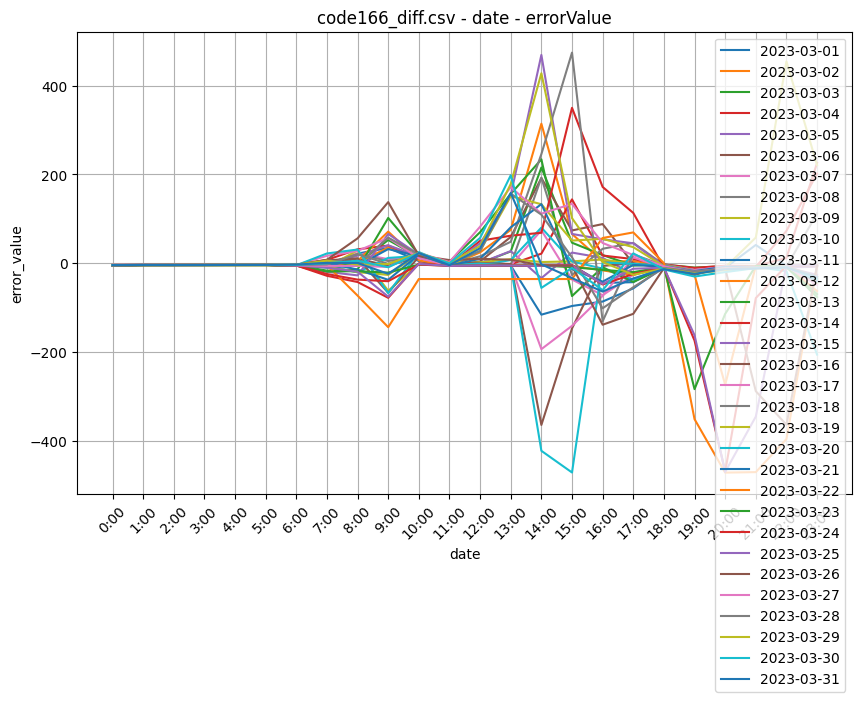

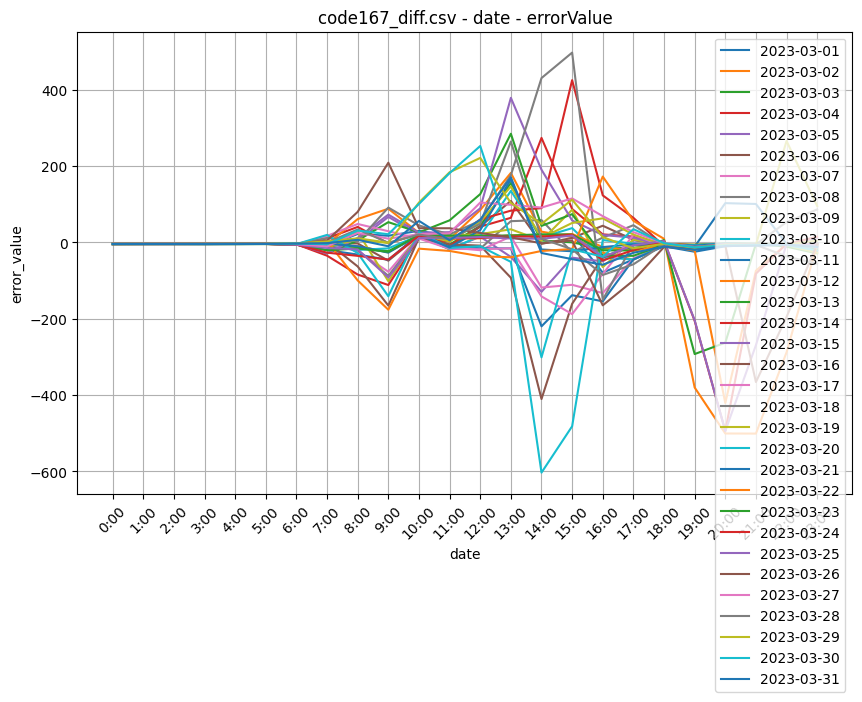

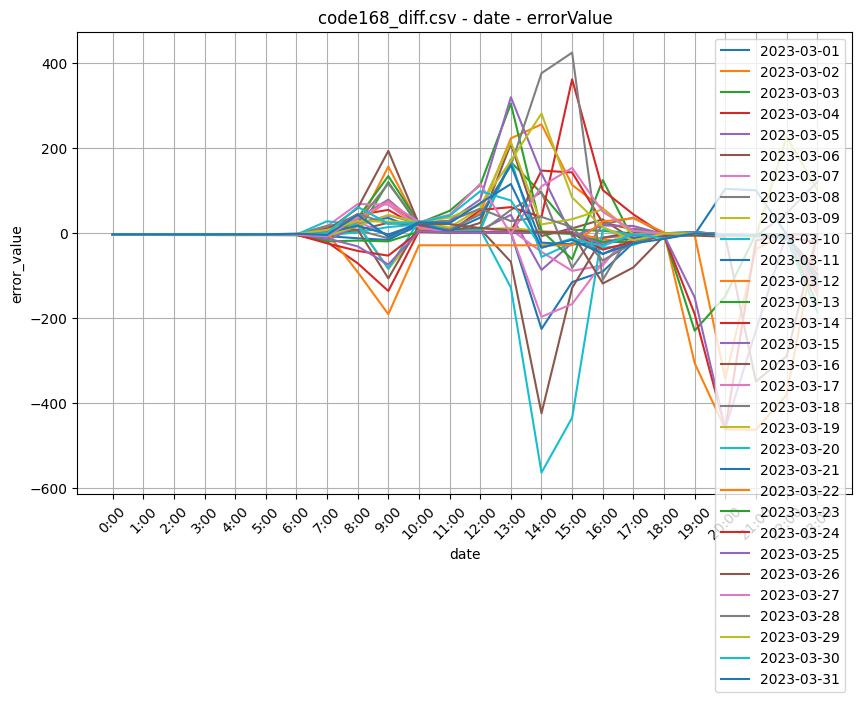

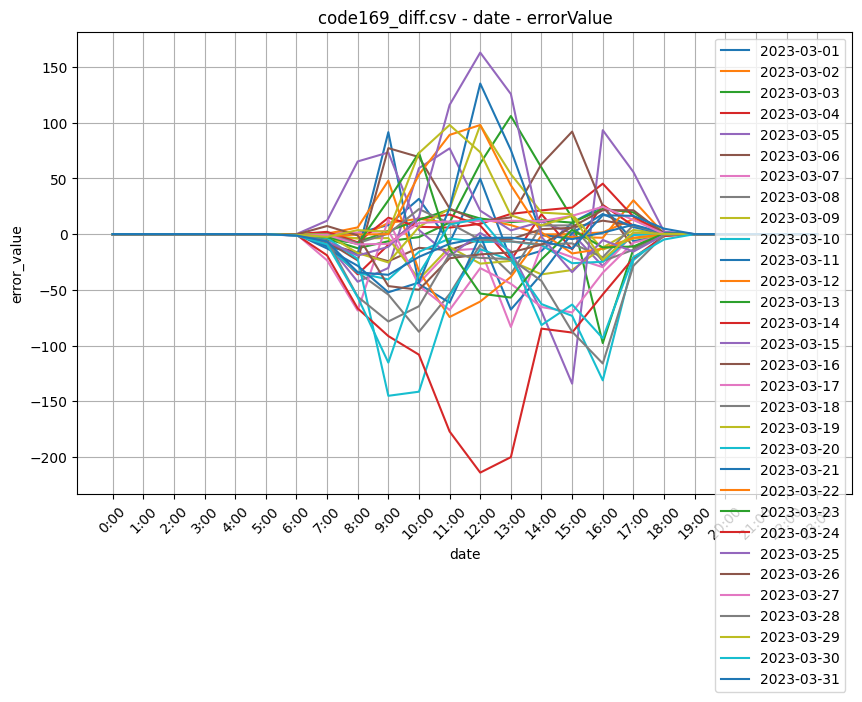

In [215]:
for i in range(1, 170):
    filename = f"code{i}_diff.csv"
    plot_diff_values(filename)

In [221]:
code1_diff_reset = code1_diff.reset_index(drop=True)
power = code1['power_plant_capacity']

# code1_diff의 값들을 설비용량으로 나누기
code1_diff_reset['ratio'] = code1_diff_reset.iloc[:, 1:].div(power)

# 업데이트된 code1_diff DataFrame 출력
print(code1_diff_reset)

ValueError: ignored

TypeError: ignored